In [1]:
import transformers

from transformers import (
    AutoConfig,
    AutoModel,
    AutoTokenizer,
    set_seed, 
)

import torch
import numpy as np

import pickle
import pandas as pd

from tqdm import tqdm

from collections import Counter

import itertools

import nltk
nltk.download('wordnet')
from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer
from pymorphy2 import MorphAnalyzer

import seaborn as sns
import matplotlib.pyplot as plt
from plotly import graph_objects as go

from scipy.stats import linregress

from config import max_seq_length
from llama_themes import themes_info

/home/chistik/.local/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


[nltk_data] Downloading package wordnet to /home/chistik/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [2]:
set_seed(41)
cache_dir="./cache"
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [3]:
def get_tokenizer(model_name, texts):
    config = AutoConfig.from_pretrained(model_name)
    if config.model_type in {"gpt2", "roberta"}:
        tokenizer = AutoTokenizer.from_pretrained(model_name, cache_dir=cache_dir, use_fast=True, add_prefix_space=True)
    else:
        tokenizer = AutoTokenizer.from_pretrained(model_name, cache_dir=cache_dir, use_fast=True)
    if tokenizer.pad_token is None:
        if tokenizer.eos_token:
            tokenizer.pad_token = tokenizer.eos_token  
        else:
            raise ValueError("The tokenizer does not have an eos_token set.")
    number_of_tokens = 0
    for index, row in texts.iterrows():
        number_of_tokens += tokenizer(row['text'], return_tensors="pt", truncation=True, max_length=max_seq_length[model_name])['input_ids'].shape[1]
    print(f'{model_name}: average sequence length is {round(number_of_tokens/len(texts))} tokens.')

In [4]:
file_path='eng_texts_terms_science(1).jsonl' # for eng
en_df = pd.read_json(path_or_buf=file_path, lines=True)
print('Language: English')
en_thematics = themes_info(en_df)

Language: English
Number of unique themes = 1792

The largest areas of knowledge in data:
Area = medicine, Number of texts = 68
Area = computer science, Number of texts = 39
Area = chemistry, Number of texts = 27
Area = materials science, Number of texts = 20
Area = psychology, Number of texts = 20


In [5]:
with open ('llama3_en_thematics.ob', 'rb') as fp:
    llama_en_thematics = pickle.load(fp)
    
with open ('llama3_ru_thematics.ob', 'rb') as fp:
    llama_ru_thematics = pickle.load(fp)

In [6]:
new_en_thematics = []

for index, item in enumerate(llama_en_thematics):
    pre_item = item.replace('\"', '').replace('\'', '').lower()
    split_items = pre_item.split()
    if 'please' in split_items or 'answer' in split_items or len(split_items) > 3:
        new_en_thematics.append(en_thematics[index])
    else:
        new_en_thematics.append(pre_item)

print(f'Reduced number of themes for English data: {len(set(new_en_thematics))}')

Reduced number of themes for English data: 222


In [7]:
Counter(new_en_thematics).most_common(5)

[('medicine', 327),
 ('computer science', 190),
 ('biology', 171),
 ('physics', 157),
 ('psychology', 122)]

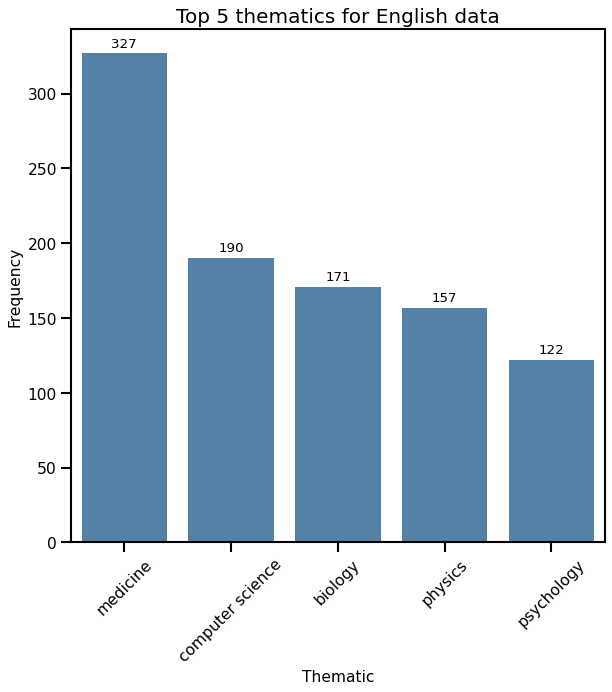

In [8]:
en_thematic_counts = Counter(new_en_thematics).most_common(5)
en_thematic_df = pd.DataFrame(en_thematic_counts, columns=['Thematic', 'Frequency'])
plt.figure(figsize=(8, 9), dpi=80)
sns.set_context("talk")  # this is one of the contexts in seaborn for larger text; others are "paper", "notebook", "talk", "poster"
barplot = sns.barplot(data=en_thematic_df, x='Thematic', y='Frequency', order=en_thematic_df['Thematic'], color='steelblue')
plt.title('Top 5 thematics for English data')
plt.xlabel('Thematic', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
for p in barplot.patches:
    barplot.annotate(format(p.get_height(), '.0f'),
                     (p.get_x() + p.get_width() / 2., p.get_height()),
                     ha='center', va='center',
                     xytext=(0, 9),
                     textcoords='offset points',
                     fontsize=12) 
plt.tight_layout()
plt.savefig("thematics_english.png")
plt.show()

In [9]:
file_path='rus_texts_terms_science(1).jsonl' # for ru
ru_df = pd.read_json(path_or_buf=file_path, lines=True)
print('Language: Russian')
ru_thematics = themes_info(ru_df)

Language: Russian
Number of unique themes = 704

The largest areas of knowledge in data:
Area = humanities, Number of texts = 452
Area = physics, Number of texts = 283
Area = political science, Number of texts = 115
Area = mathematics, Number of texts = 80
Area = medicine, Number of texts = 62


In [10]:
new_ru_thematics = []

for index, item in enumerate(llama_ru_thematics):
    pre_item = item.replace('\"', '').replace('\'', '').lower()
    split_items = pre_item.split()
    if 'please' in split_items or 'answer' in split_items or len(split_items) > 3:
        new_ru_thematics.append(ru_thematics[index])
    else:
        new_ru_thematics.append(pre_item)
print(f'Reduced number of themes for Russian data: {len(set(new_ru_thematics))}')

Reduced number of themes for Russian data: 117


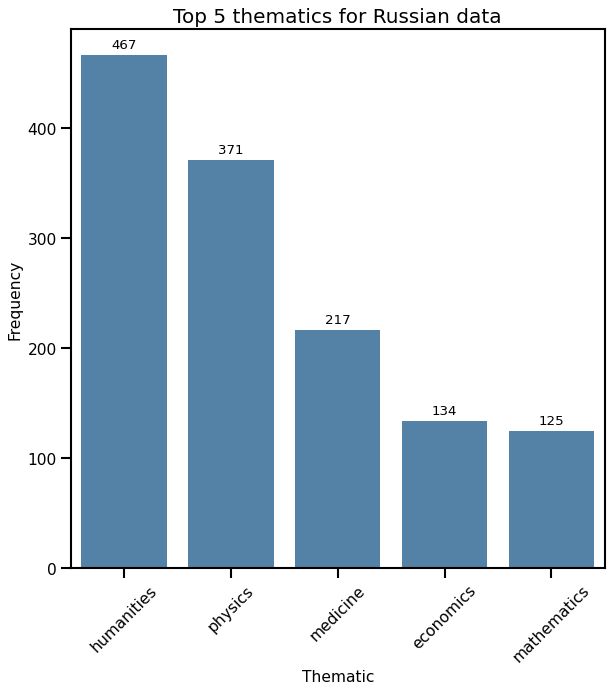

In [11]:
ru_thematic_counts = Counter(new_ru_thematics).most_common(5)
ru_thematic_df = pd.DataFrame(ru_thematic_counts, columns=['Thematic', 'Frequency'])
plt.figure(figsize=(8, 9), dpi=80)
sns.set_context("talk")  # this is one of the contexts in seaborn for larger text; others are "paper", "notebook", "talk", "poster"
barplot = sns.barplot(data=ru_thematic_df, x='Thematic', y='Frequency', order=ru_thematic_df['Thematic'], color='steelblue')
plt.title('Top 5 thematics for Russian data')
plt.xlabel('Thematic', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.xticks(rotation=45, fontsize=14)
plt.yticks(fontsize=14)
for p in barplot.patches:
    barplot.annotate(format(p.get_height(), '.0f'),
                     (p.get_x() + p.get_width() / 2., p.get_height()),
                     ha='center', va='center',
                     xytext=(0, 9),
                     textcoords='offset points',
                     fontsize=12) 
plt.tight_layout()
plt.savefig("thematics_russian.png")
plt.show()

In [12]:
en_model_names = [
'google-bert/bert-base-uncased',
'google-bert/bert-base-multilingual-uncased',
'openai-community/gpt2',
]
ru_model_names = [
'DeepPavlov/rubert-base-cased',
'google-bert/bert-base-multilingual-uncased',
'ai-forever/rugpt3small_based_on_gpt2']

print('English')
for name in en_model_names:
    get_tokenizer(name, en_df)
print()

print('Russian')
for name in ru_model_names:
    get_tokenizer(name, ru_df)

English
google-bert/bert-base-uncased: average sequence length is 237 tokens.
google-bert/bert-base-multilingual-uncased: average sequence length is 247 tokens.
openai-community/gpt2: average sequence length is 241 tokens.

Russian
DeepPavlov/rubert-base-cased: average sequence length is 186 tokens.
google-bert/bert-base-multilingual-uncased: average sequence length is 245 tokens.


ai-forever/rugpt3small_based_on_gpt2: average sequence length is 232 tokens.


In [13]:
params = {}
for model_name in ['google-bert/bert-base-uncased', 'DeepPavlov/rubert-base-cased', 'google-bert/bert-base-multilingual-uncased',
                    'openai-community/gpt2', 'ai-forever/rugpt3small_based_on_gpt2']:
    config = AutoConfig.from_pretrained(model_name)
    model = AutoModel.from_pretrained(
            model_name,
            config=config,
            cache_dir=cache_dir,
            torch_dtype=config.torch_dtype).to(device)
    params[model_name] = sum(p.numel() for p in model.parameters())

/ibex/user/chistik/conda-environments/py39/lib/python3.9/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
Some weights of the model checkpoint at DeepPavlov/rubert-base-cased were not used when initializing BertModel: ['cls.predictions.bias', 'cls.predictions.decoder.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g.

In [14]:
for model_name, number_params in params.items():
    print(model_name, ':', number_params, 'parameters')

google-bert/bert-base-uncased : 109482240 parameters
DeepPavlov/rubert-base-cased : 177853440 parameters
google-bert/bert-base-multilingual-uncased : 167356416 parameters
openai-community/gpt2 : 124439808 parameters
ai-forever/rugpt3small_based_on_gpt2 : 125231616 parameters


In [15]:
def label_row(row, language='en'):
    text = row['text'].lower()
    tokenizer = RegexpTokenizer(r'\w+')
    tokens = tokenizer.tokenize(text)
    if language == 'en':
        lemmatizer = WordNetLemmatizer() 
        lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]
    elif language == 'ru':
        morph = MorphAnalyzer()
        lemmatized_tokens = [morph.parse(token)[0].normal_form for token in tokens]

    assert len(tokens) == len(lemmatized_tokens)
    
    labels = []
    terms_with_counts = []
    for term_group in row['terms'].keys(): # different groups for terms like 'NP', 'PERSON', 'ORG'
        terms_with_counts.extend(row['terms'][term_group])
    flattened_terms = list(itertools.chain.from_iterable([[term] * count for term_dict in terms_with_counts for term in term_dict['term'].split('_') for count in [term_dict['count']]]))

    for word in lemmatized_tokens:
        if word in flattened_terms:
            labels.append('term')
            flattened_terms.remove(word)
        else:
            labels.append('not_term')
    assert len(tokens) == len(labels)
    return tokens, labels

In [16]:
label_list=['term', 'not_term']
label_to_id = {l: i for i, l in enumerate(label_list)}
id2label = {i: l for l, i in label_to_id.items()}

In [17]:
file_path='eng_texts_terms_science(1).jsonl' # for eng
en_df = pd.read_json(path_or_buf=file_path, lines=True)

file_path='rus_texts_terms_science(1).jsonl' # for ru
ru_df = pd.read_json(path_or_buf=file_path, lines=True)
data = {
    'text': [],
    'terms': []
}

for index, row in tqdm(en_df.iterrows()):
    tokens, labels = label_row(row, language='en')
    data['text'].append(tokens)
    data['terms'].append(labels)

en_df = pd.DataFrame(data)
en_df.dropna(inplace=True)
assert len(en_df) == 2500
en_df['term_count'] = en_df['terms'].apply(lambda terms_list: terms_list.count('term'))
average_terms = en_df['term_count'].mean()


# the average text length
en_df['text_length'] = en_df['text'].apply(lambda text: len(text))
average_text_length = en_df['text_length'].mean()

if len(new_en_thematics) == len(en_df):
    en_df['theme'] = new_en_thematics

print(f"Average number of terms per text: {round(average_terms)}")
print(f"Average text length (in words): {round(average_text_length)}")

2500it [00:03, 717.91it/s] 

Average number of terms per text: 72
Average text length (in words): 177


In [18]:
en_df.to_csv('en_df.csv', index=False) 

In [19]:
data = {
    'text': [],
    'terms': []
}

for index, row in tqdm(ru_df.iterrows()):
    tokens, labels = label_row(row, language='ru')
    data['text'].append(tokens)
    data['terms'].append(labels)

ru_df = pd.DataFrame(data)
ru_df.dropna(inplace=True)
assert len(ru_df) == 2500
ru_df['term_count'] = ru_df['terms'].apply(lambda terms_list: terms_list.count('term'))
average_terms = ru_df['term_count'].mean()

# the average text length
ru_df['text_length'] = ru_df['text'].apply(lambda text: len(text))
average_text_length = ru_df['text_length'].mean()

if len(new_ru_thematics) == len(ru_df):
    ru_df['theme'] = new_ru_thematics

print(f"Average number of 'term's per text: {round(average_terms)}")
print(f"Average text length (in words): {round(average_text_length)}")

400it [01:43,  3.78it/s]

2500it [11:00,  3.79it/s]

Average number of 'term's per text: 34
Average text length (in words): 132


In [20]:
ru_df.to_csv('ru_df.csv', index=False) 

In [21]:
def flatten_words_labels(texts, labels):
    return [(word, label)
            for tokens, labels in zip(texts, labels)
            for word, label in zip(tokens, labels)]

def plot_zipf(df, language='English'):
    all_words_labels = flatten_words_labels(df['text'], df['terms'])
    words, labels = zip(*all_words_labels)
    word_freq = Counter(words)
    sorted_words = sorted(word_freq, key=word_freq.get, reverse=True) # sort by frequency
    sorted_freqs = [word_freq[word] for word in sorted_words]
    word_to_label = dict(all_words_labels)
    sorted_labels = [word_to_label[word] for word in sorted_words]
    df_plot = pd.DataFrame({
        'Word': sorted_words,
        'Frequency': sorted_freqs,
        'Rank': range(1, len(sorted_freqs) + 1),
        'Label': sorted_labels
    })
    # expected frequency of each word under Zipfian distribution
    df_plot['Zipf_Frequency'] = df_plot['Frequency'][0] / df_plot['Rank']

    color_mapping = {'term': 'blue', 'not_term': 'green'}
    df_plot['Color'] = df_plot['Label'].map(color_mapping)
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=df_plot['Rank'], y=df_plot['Frequency'], mode='markers',
        marker=dict(color=df_plot['Color'], opacity=0.4), text=df_plot['Word'],
        name='Frequency'
    ))

    fig.add_trace(go.Scatter(
        x=df_plot['Rank'], y=df_plot['Zipf_Frequency'], mode='lines',
        line=dict(color='orange', width=2), name="Zipf's Law"
    ))

    fig.update_layout(
        title=f"Zipf's Law Visualization ({language} data)", title_x=0.5,
        xaxis=dict(title='Rank of word (log scale)', type='log'),
        yaxis=dict(title='Frequency of word (log scale)', type='log'),
        legend=dict(yanchor="top", y=0.99, xanchor="right", x=0.99)
    )

    fig.show()

    def calculate_zipf_metrics(df): 
        log_ranks = np.log(df['Rank']) 
        log_freqs = np.log(df['Frequency']) 
        slope, intercept, r_value, p_value, std_err = linregress(log_ranks, log_freqs) 
        return slope, intercept, r_value, p_value, std_err 

    slope, intercept, r_value, p_value, std_err = calculate_zipf_metrics(df_plot)
    # value close to -1 -> dataset follows Zipf's law; ideal slope would be -1
    print(f"Slope: {slope}")
    print(f"Intercept: {intercept}")
    # r-value close to -1 suggests a strong negative linear relationship
    print(f"Correlation coefficient (r): {r_value}")
    # null hypothesis that the slope is zero (no relationship)
    print(f"p-value: {p_value}")

In [22]:
plot_zipf(en_df)

Slope: -1.24198252525664
Intercept: 12.656285203335177
Correlation coefficient (r): -0.9852755202537794
p-value: 0.0


In [23]:
plot_zipf(ru_df, language='Russian')

Slope: -0.9615913225708247
Intercept: 10.267952875354094
Correlation coefficient (r): -0.9812541755645335
p-value: 0.0
